<a href="https://colab.research.google.com/github/princessdlpz/MALDASAC_Project_RSNA_Mammography/blob/main/colored_bottle_detection_yolov8_train_and_predict.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# TACO YOLOv8 Model Train and Predict

In [ ]:
%pip install ultralytics

In [ ]:
!pip install scikit-learn

In [ ]:
import os
import collections
import cv2
import numpy as np
import pandas as pd
from tqdm import tqdm
import shutil
from shutil import copyfile
import matplotlib.pyplot as plt
from matplotlib import animation, rc
rc('animation', html='jshtml')
from PIL import Image

import ultralytics
from ultralytics import YOLO
ultralytics.checks()

Ultralytics YOLOv8.2.2 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
Setup complete ✅ (8 CPUs, 51.0 GB RAM, 29.2/201.2 GB disk)


# Data Preparation

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!unzip -q /content/drive/MyDrive/MastersThesis/Color_GlassBottle_Detection.v1i.yolov8.zip -d /content/drive/MyDrive/MastersThesis/custom_dataset

replace /content/drive/MyDrive/MastersThesis/custom_dataset/README.dataset.txt? [y]es, [n]o, [A]ll, [N]one, [r]ename: N


In [ ]:
!unzip -q /content/drive/MyDrive/MastersThesis/Taco_Dataset.zip -d /content/drive/MyDrive/MastersThesis/taco_dataset

replace /content/drive/MyDrive/MastersThesis/taco_dataset/README.dataset.txt? [y]es, [n]o, [A]ll, [N]one, [r]ename: N


In [ ]:
!ls /content/drive/MyDrive/MastersThesis/custom_dataset

data.yaml  README.dataset.txt  README.roboflow.txt  test  train  valid


In [ ]:
def show_image(path_image):
    img = mpimg.imread(path_image)
    imgplot = plt.imshow(img)
    plt.show()

def get_images_path():
    all_image_paths = []
    for dirname, _, filenames in os.walk('/content/drive/MyDrive/MastersThesis/custom_dataset'):
        for filename in filenames:
            if(filename[len(filename)-3:] == "jpg"):
                all_image_paths.append(os.path.join(dirname, filename))

    return all_image_paths

def get_class_info():
    class_counts = collections.Counter()
    classes = []
    for dirname, dirnames, filenames in os.walk('/content/drive/MyDrive/MastersThesis/custom_dataset'):
        for subdirname in dirnames:
            classes.append(subdirname)
            class_counts[subdirname] += len(os.listdir(os.path.join(dirname, subdirname)))

    return classes, class_counts

annotations_path = '/content/drive/MyDrive/MastersThesis/custom_dataset/annotations.txt'


if __name__ == '__main__':
    num_images = len(get_images_path())
    classes, class_counts = get_class_info()
    annotations_path = '/content/drive/MyDrive/MastersThesis/custom_dataset/annotations.txt'

    print("Number of images:", num_images)
    print("Number of classes:", len(classes))
    print("Classes:", classes)
    print("Class counts:", class_counts)
    print("Path to annotations:", annotations_path)

Number of images: 1114
Number of classes: 9
Classes: ['valid', 'test', 'train', 'images', 'labels', 'images', 'labels', 'labels', 'images']
Class counts: Counter({'images': 1114, 'labels': 1114, 'valid': 3, 'train': 3, 'test': 2})
Path to annotations: /content/drive/MyDrive/MastersThesis/custom_dataset/annotations.txt


In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="MK3u02Zmh83Ad10Gu9gF")
project = rf.workspace("thesis-xozd3").project("color_glassbottle_detection")
version = project.version(1)
dataset = version.download("yolov8")

loading Roboflow workspace...
loading Roboflow project...
Dependency ultralytics==8.0.196 is required but found version=8.2.2, to fix: `pip install ultralytics==8.0.196`


# Data Preparation

In [ ]:
import yaml

%cat data.yaml

In [ ]:
class_names = [
    'blue_glass_bottle',
    'brown_glass_bottle',
    'clear_glass_bottle',
    'dark_glass_bottle',
    'green_glass_bottle',
    'other_glass_bottle',
    'pink_glass_bottle'
]

class_map = dict(enumerate(class_names))

# Train

In [ ]:
model = YOLO("yolov8x.pt")

In [ ]:
!yolo task=detect mode=train model=yolov8x.pt data=/content/drive/MyDrive/MastersThesis/custom_dataset/data.yaml epochs=100 imgsz=640

Ultralytics YOLOv8.2.2 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
engine/trainer: task=detect, mode=train, model=yolov8x.pt, data=/content/drive/MyDrive/MastersThesis/custom_dataset/data.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop

# Result of Training

In [ ]:
paths2=[]
for dirname, _, filenames in os.walk('/content/runs/detect/train'):
    for filename in filenames:
        if filename[-4:]=='.jpg':
            paths2+=[(os.path.join(dirname, filename))]
paths2=sorted(paths2)

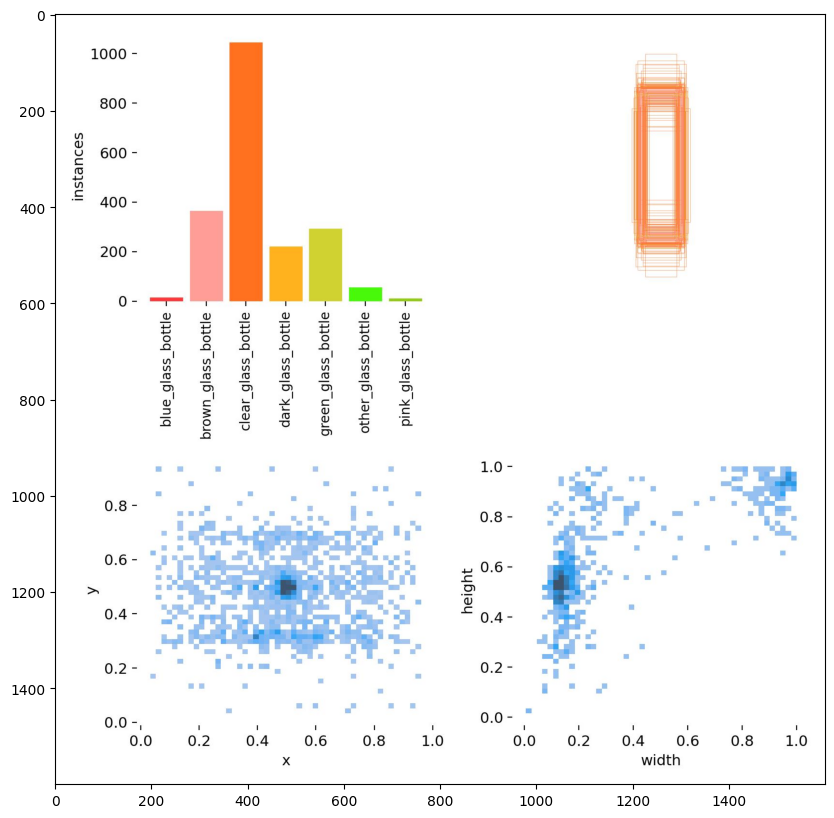

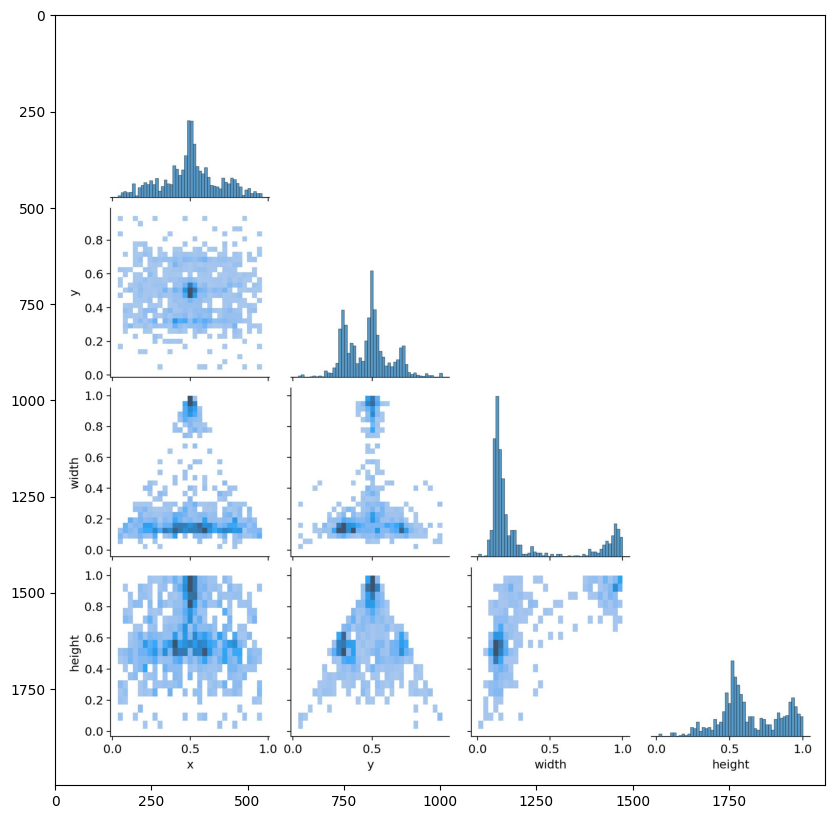

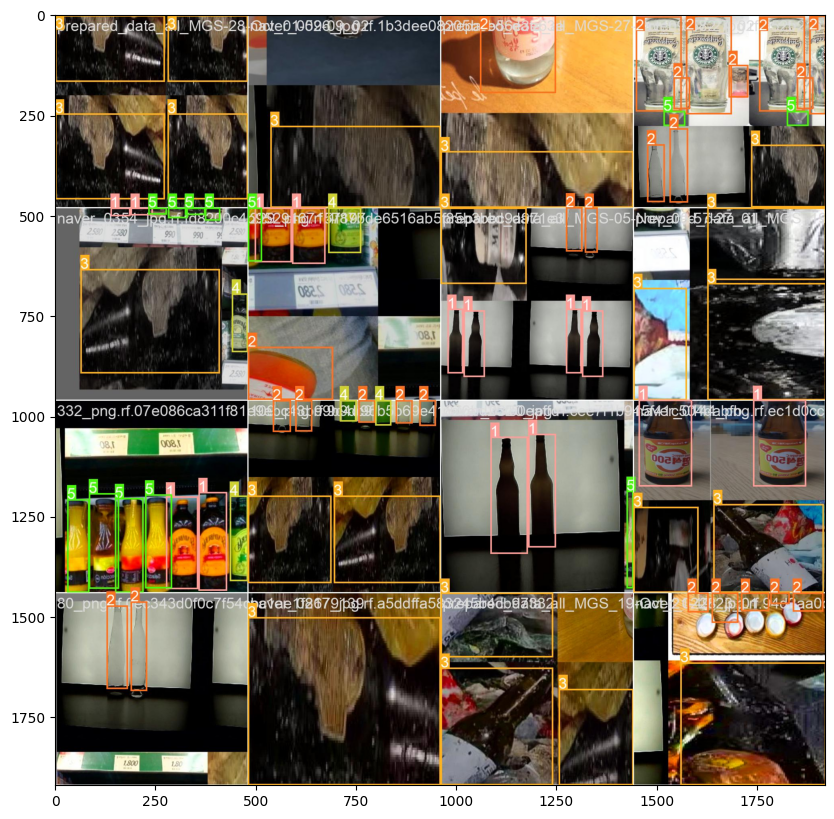

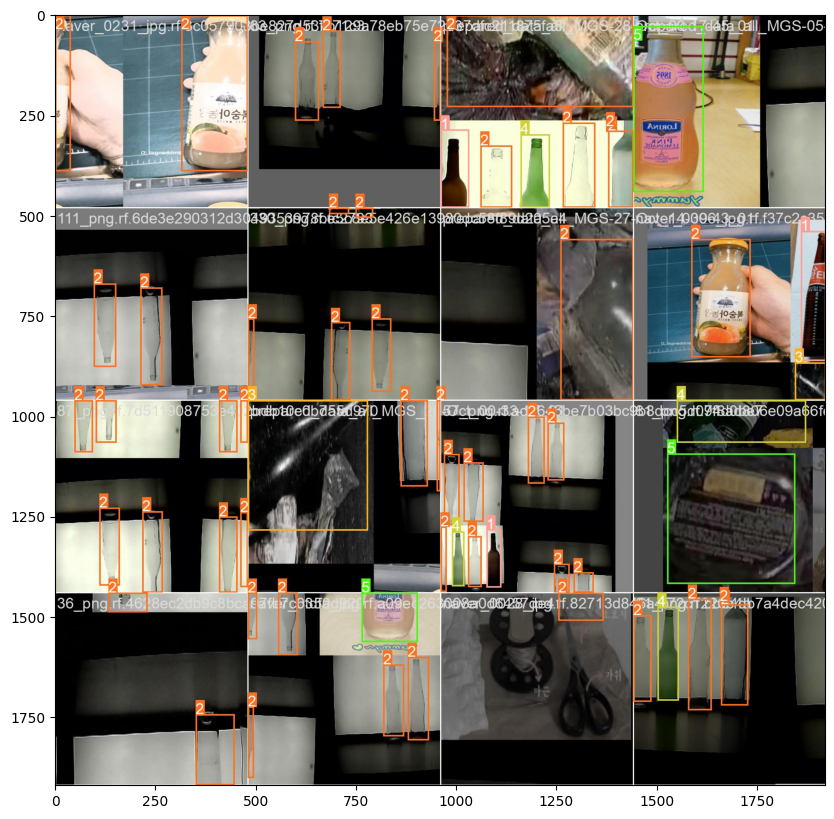

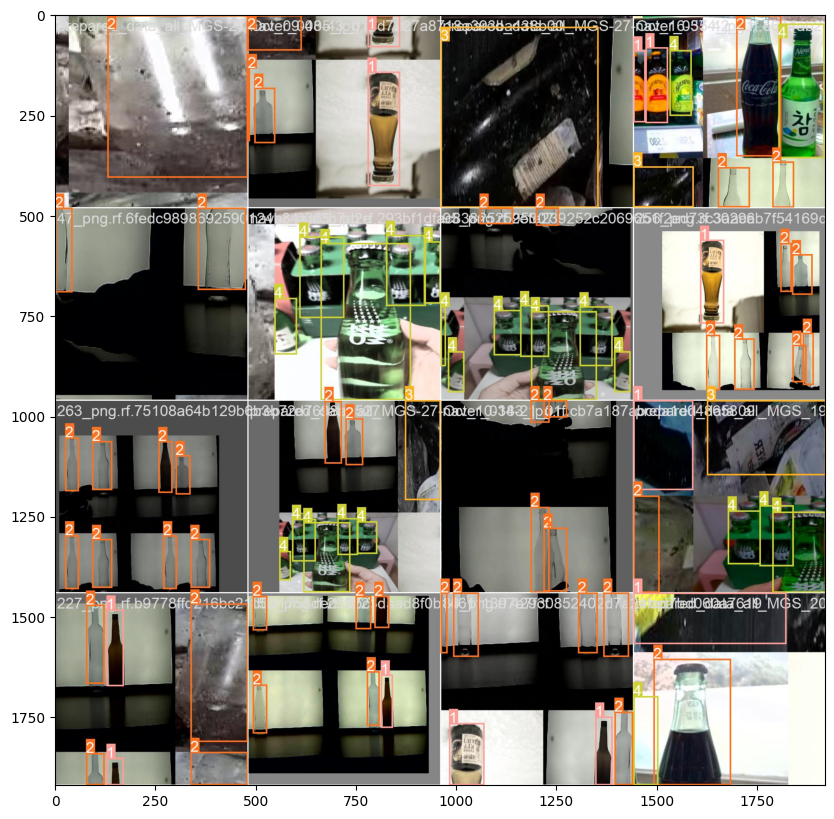

...

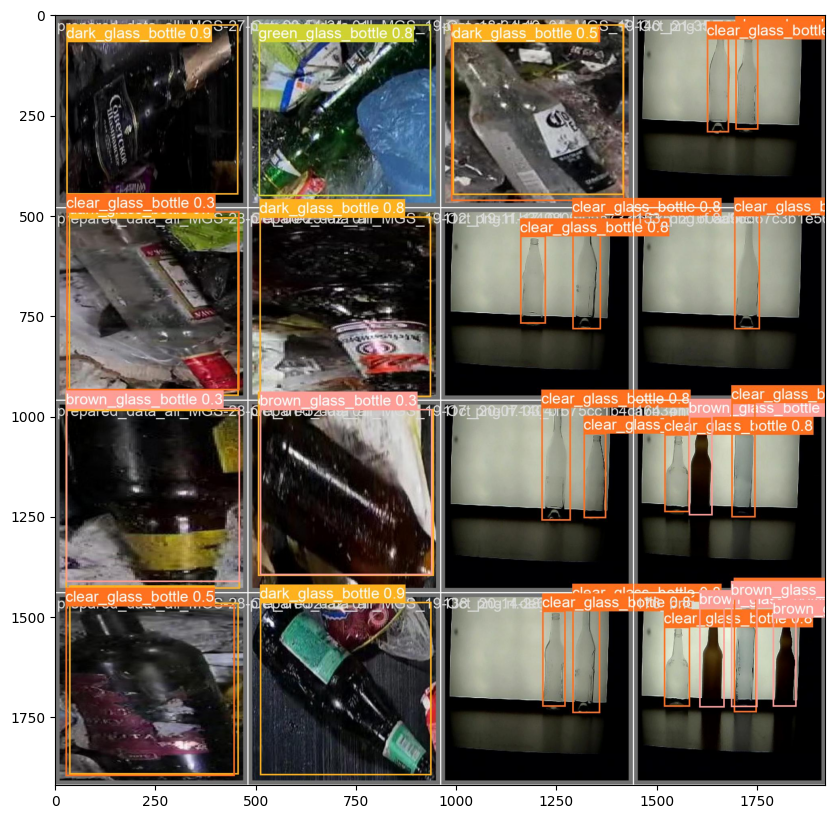

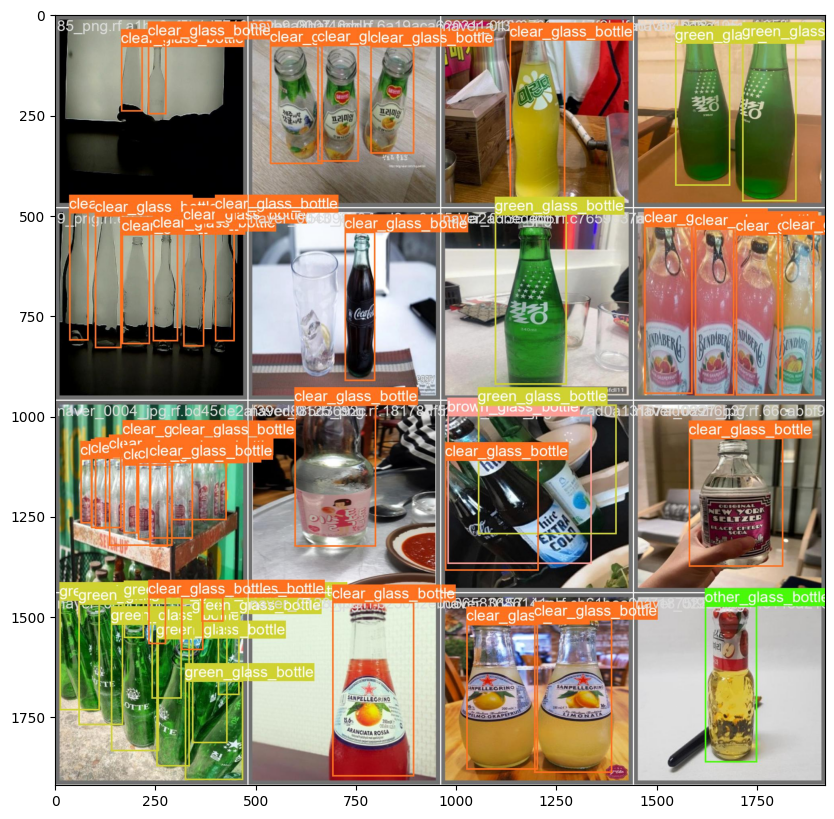

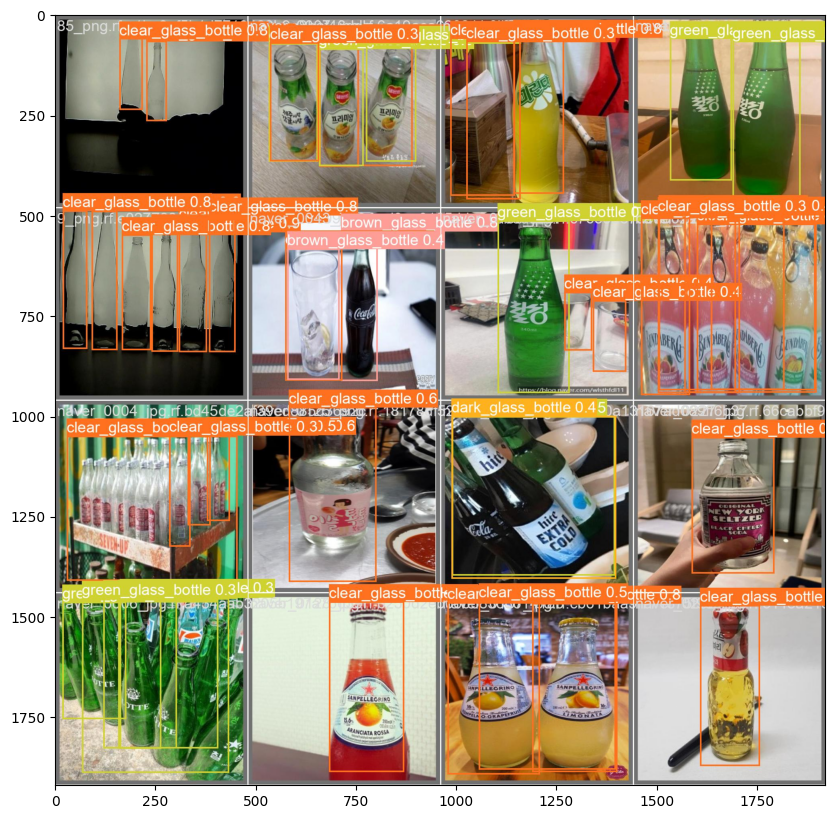

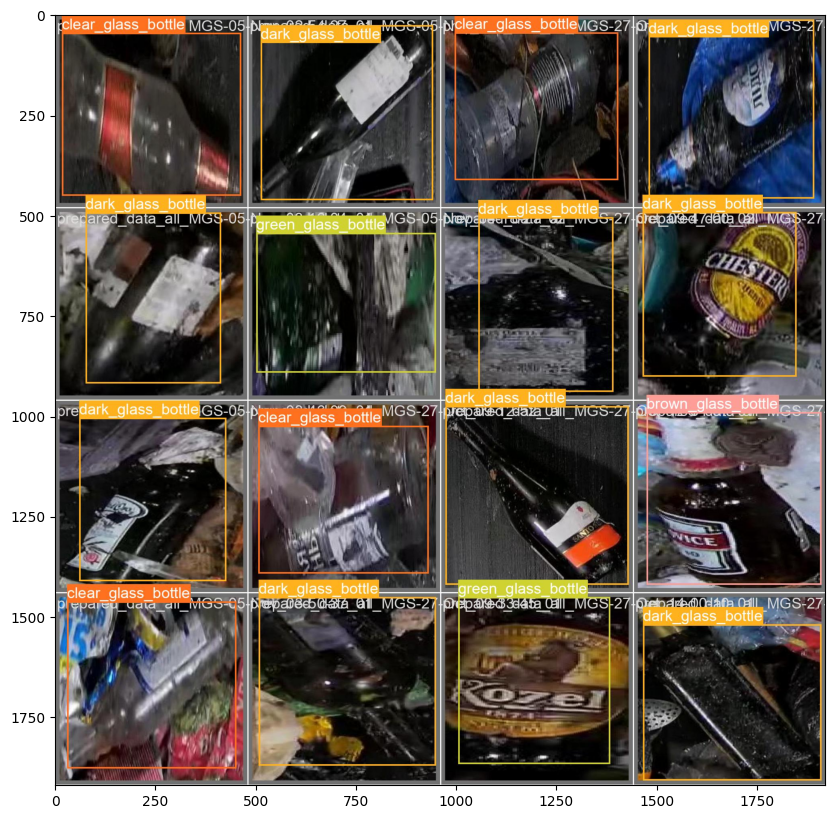

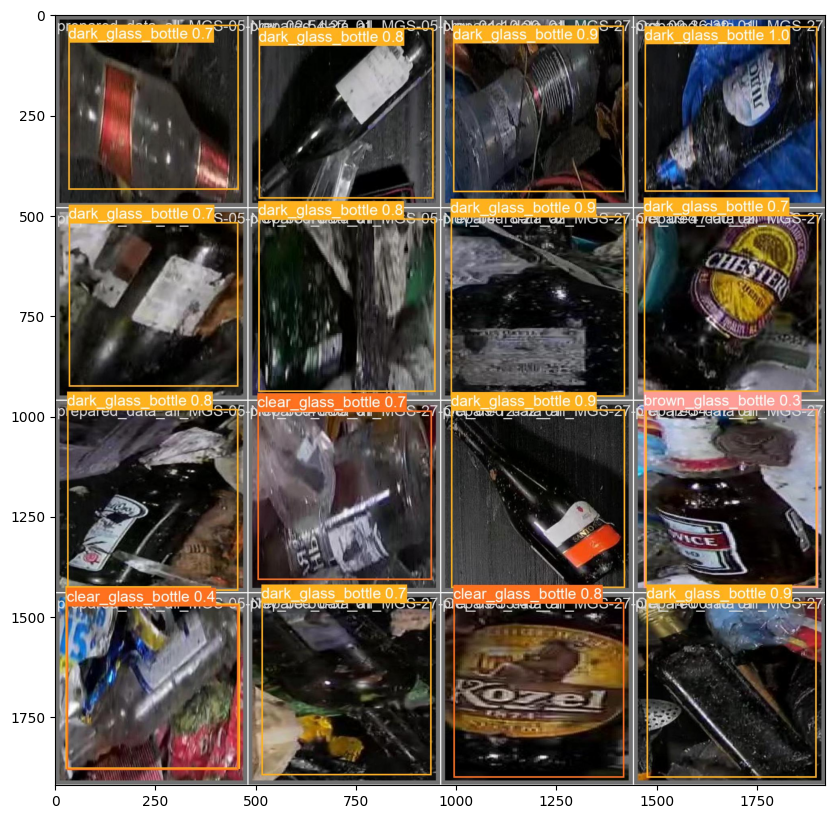

In [ ]:
for path in paths2:
    image = Image.open(path)
    image=np.array(image)
    plt.figure(figsize=(20,10))
    plt.imshow(image)
    plt.show()

# Predict

In [ ]:
best_path0='/content/runs/detect/train/weights/best.pt'
source0='/content/drive/MyDrive/MastersThesis/custom_dataset/test/images'

In [ ]:
ppaths=[]
for dirname, _, filenames in os.walk(source0):
    for filename in filenames:
        if filename[-4:]=='.jpg':
            ppaths+=[(os.path.join(dirname, filename))]
ppaths=sorted(ppaths)
print(ppaths[0])
print(len(ppaths))

/content/drive/MyDrive/MastersThesis/custom_dataset/test/images/128_png.rf.18a1bc5912a91dc8f9fdce67eb3207cf.jpg
46


In [ ]:
model2 = YOLO(best_path0)

In [ ]:
!yolo task=detect mode=predict model={best_path0} conf=0.1 source={source0}

Ultralytics YOLOv8.2.2 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
Model summary (fused): 268 layers, 68130309 parameters, 0 gradients, 257.4 GFLOPs

image 1/46 /content/drive/MyDrive/MastersThesis/custom_dataset/test/images/128_png.rf.18a1bc5912a91dc8f9fdce67eb3207cf.jpg: 640x640 2 clear_glass_bottles, 21.7ms
image 2/46 /content/drive/MyDrive/MastersThesis/custom_dataset/test/images/14_png.rf.9f1934236e073013eb053757b041736f.jpg: 640x640 2 clear_glass_bottles, 21.7ms
image 3/46 /content/drive/MyDrive/MastersThesis/custom_dataset/test/images/204_png.rf.0bbfc30d84e8064b41ae644d7d454319.jpg: 640x640 2 brown_glass_bottles, 21.7ms
image 4/46 /content/drive/MyDrive/MastersThesis/custom_dataset/test/images/220_png.rf.add5f53fbcbaaaabb325dd72698661a1.jpg: 640x640 2 brown_glass_bottles, 1 clear_glass_bottle, 21.7ms
image 5/46 /content/drive/MyDrive/MastersThesis/custom_dataset/test/images/226_png.rf.1b3e6d08824e7b45f0dbf86277f85790.jpg: 640x640 1 brown_glass_bott

# Result of Prediction

In [ ]:
results = model2.predict(source0,conf=0.1)
print(len(results))


image 1/46 /content/drive/MyDrive/MastersThesis/custom_dataset/test/images/128_png.rf.18a1bc5912a91dc8f9fdce67eb3207cf.jpg: 640x640 2 clear_glass_bottles, 21.6ms
image 2/46 /content/drive/MyDrive/MastersThesis/custom_dataset/test/images/14_png.rf.9f1934236e073013eb053757b041736f.jpg: 640x640 2 clear_glass_bottles, 21.7ms
image 3/46 /content/drive/MyDrive/MastersThesis/custom_dataset/test/images/204_png.rf.0bbfc30d84e8064b41ae644d7d454319.jpg: 640x640 2 brown_glass_bottles, 21.6ms
image 4/46 /content/drive/MyDrive/MastersThesis/custom_dataset/test/images/220_png.rf.add5f53fbcbaaaabb325dd72698661a1.jpg: 640x640 2 brown_glass_bottles, 1 clear_glass_bottle, 21.6ms
image 5/46 /content/drive/MyDrive/MastersThesis/custom_dataset/test/images/226_png.rf.1b3e6d08824e7b45f0dbf86277f85790.jpg: 640x640 1 brown_glass_bottle, 1 clear_glass_bottle, 21.6ms
image 6/46 /content/drive/MyDrive/MastersThesis/custom_dataset/test/images/264_png.rf.d34ce19ec35a76436d2b8ad51828c08c.jpg: 640x640 1 brown_glass_b

In [ ]:
print((results[0].boxes.data))

tensor([[348.2255,   5.4000, 437.3640, 401.5767,   0.7981,   2.0000],
        [222.4528,  80.6630, 305.3819, 386.1639,   0.7633,   2.0000]], device='cuda:0')


In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, confusion_matrix
import pandas as pd

Valid_model = YOLO('/content/runs/detect/train/weights/best.pt')

In [ ]:
metrics = Valid_model.val(split = 'test')

Ultralytics YOLOv8.2.2 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
Model summary (fused): 268 layers, 68130309 parameters, 0 gradients, 257.4 GFLOPs


val: Scanning /content/drive/MyDrive/MastersThesis/custom_dataset/test/labels... 46 images, 0 backgrounds, 0 corrupt: 100%|██████████| 46/46 [00:03<00:00, 14.29it/s]

val: New cache created: /content/drive/MyDrive/MastersThesis/custom_dataset/test/labels.cache



os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:03<00:00,  1.07s/it]


                   all         46         84      0.841      0.917      0.928      0.594
    brown_glass_bottle         46         25      0.909      0.801      0.876      0.542
    clear_glass_bottle         46         35      0.805      0.943       0.92      0.497
     dark_glass_bottle         46         11      0.743          1      0.937      0.625
    green_glass_bottle         46         13      0.909      0.923       0.98      0.711
Speed: 2.9ms preprocess, 35.1ms inference, 0.0ms loss, 11.2ms postprocess per image
Results saved to runs/detect/val


In [ ]:
print("precision(B): ", metrics.results_dict["metrics/precision(B)"])
print("metrics/recall(B): ", metrics.results_dict["metrics/recall(B)"])
print("metrics/mAP50(B): ", metrics.results_dict["metrics/mAP50(B)"])
print("metrics/mAP50-95(B): ", metrics.results_dict["metrics/mAP50-95(B)"])

precision(B):  0.8414864288904614
metrics/recall(B):  0.9166942956247837
metrics/mAP50(B):  0.9281337088148487
metrics/mAP50-95(B):  0.5939793458774331


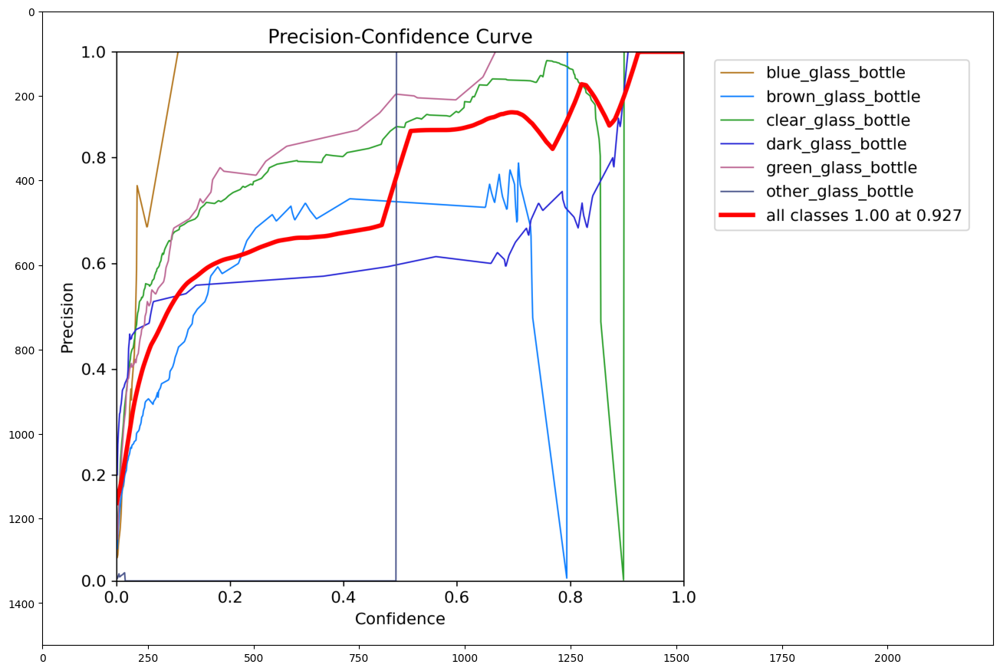

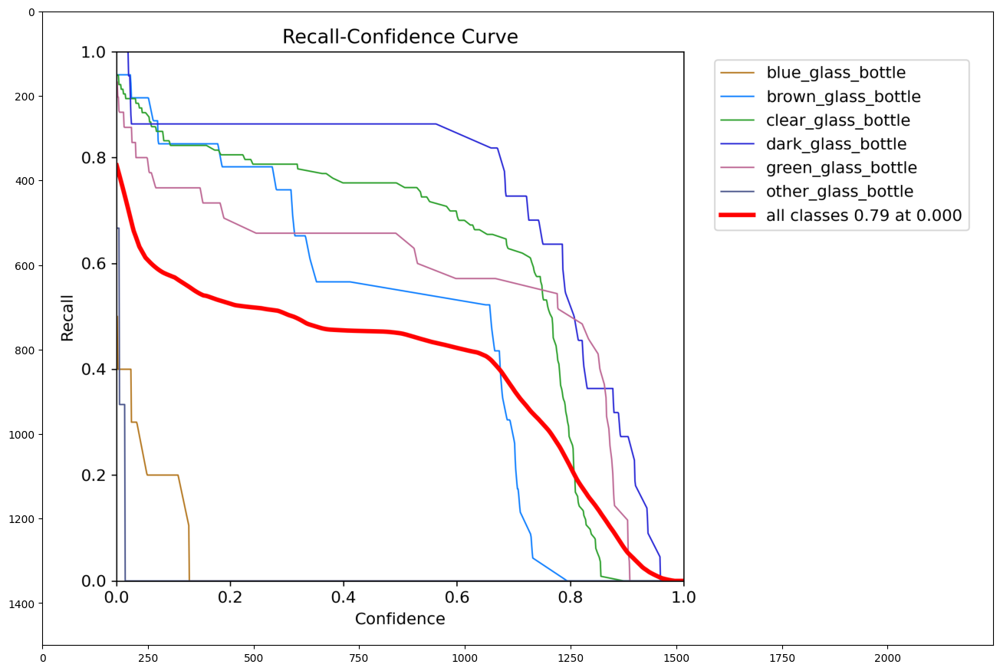

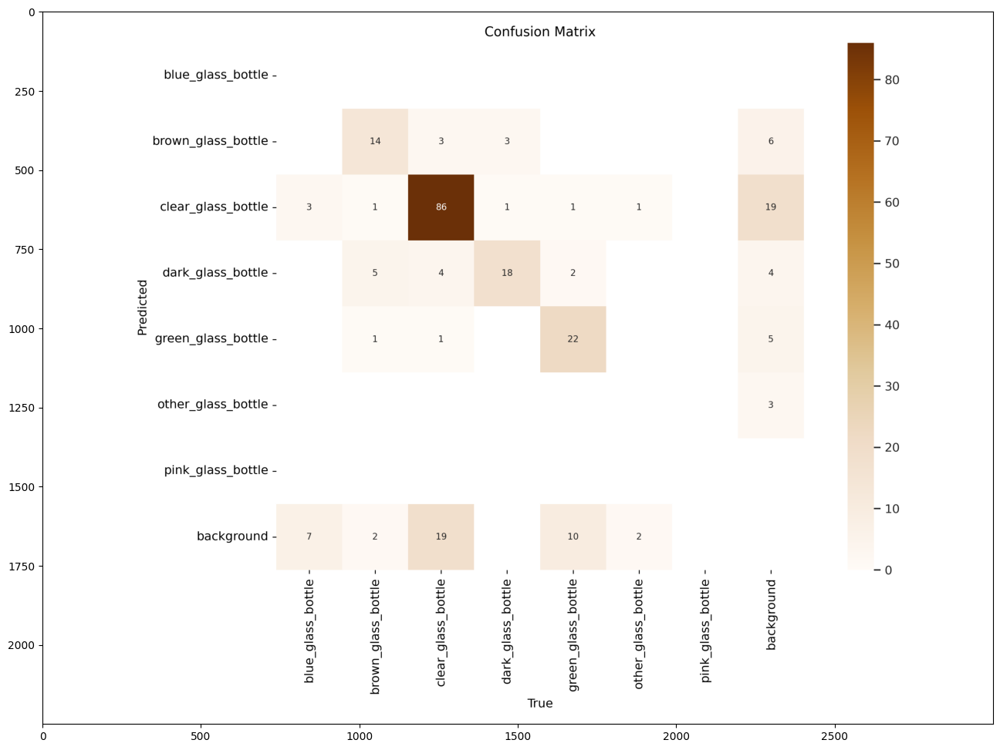

In [ ]:
list_of_metrics = ["P_curve.png","R_curve.png","confusion_matrix.png"]
# Load the image
for i in list_of_metrics:
    image = cv2.imread(f'/content/runs/detect/train/{i}')

    # Create a larger figure
    plt.figure(figsize=(16, 12))

    # Display the image
    plt.imshow(image)

    # Show the plot
    plt.show()

In [ ]:
Result_Final_model = pd.read_csv('/content/runs/detect/train/results.csv')
Result_Final_model.tail(10)

,epoch,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
90,91,0.71790,0.41998,1.1754,0.45498,0.53131,0.51280,0.30356,1.4919,1.1741,2.1035,0.000099,0.000099,0.000099
91,92,0.67596,0.38847,1.1483,0.44641,0.57893,0.51800,0.30936,1.4822,1.2053,2.1280,0.000090,0.000090,0.000090
92,93,0.66483,0.37124,1.1516,0.43712,0.57969,0.52627,0.31054,1.4915,1.182,2.0972,0.000081,0.000081,0.000081
93,94,0.65584,0.37156,1.1238,0.44062,0.59285,0.50618,0.29157,1.4899,1.204,2.1338,0.000072,0.000072,0.000072
94,95,0.63434,0.36711,1.1177,0.42542,0.59296,0.51432,0.29820,1.4800,1.2078,2.1137,0.000063,0.000063,0.000063
95,96,0.63209,0.36124,1.1155,0.44570,0.58112,0.51469,0.30096,1.4894,1.2132,2.1169,0.000054,0.000054,0.000054
96,97,0.61815,0.35142,1.1133,0.50063,0.54490,0.51400,0.30177,1.4993,1.1996,2.1489,0.000045,0.000045,0.000045
97,98,0.60749,0.34896,1.1075,0.51506,0.58274,0.52159,0.30568,1.4878,1.1775,2.1567,0.000036,0.000036,0.000036
98,99,0.59775,0.34384,1.0946,0.53038,0.57097,0.52504,0.30379,1.4883,1.1533,2.1585,0.000027,0.000027,0.000027
99,100,0.61797,0.35232,1.0984,0.52436,0.54694,0.51996,0.30480,1.4937,1.1588,2.1629,0.000018,0.000018,0.000018


In [ ]:
PBOX=pd.DataFrame(columns=range(6))
for i in range(len(results)):
    arri=pd.DataFrame(results[i].boxes.data.cpu().numpy()).astype(float)
    path=ppaths[i]
    file=path.split('/')[-1]
    arri=arri.assign(file=file)
    arri=arri.assign(i=i)
    PBOX=pd.concat([PBOX,arri],axis=0)
PBOX.columns=['x','y','x2','y2','confidence','class','file','i']
display(PBOX)

,x,y,x2,y2,confidence,class,file,i
0,348.225525,5.399963,437.363953,401.576721,0.798143,2.0,128_png.rf.18a1bc5912a91dc8f9fdce67eb3207cf.jpg,0.0
1,222.452805,80.662994,305.381897,386.163910,0.763335,2.0,128_png.rf.18a1bc5912a91dc8f9fdce67eb3207cf.jpg,0.0
0,308.680573,68.577271,386.134735,422.625702,0.813899,2.0,14_png.rf.9f1934236e073013eb053757b041736f.jpg,1.0
1,206.481903,74.667755,292.461456,419.323212,0.796971,2.0,14_png.rf.9f1934236e073013eb053757b041736f.jpg,1.0
0,199.689056,27.517059,302.210175,385.561798,0.706818,1.0,204_png.rf.0bbfc30d84e8064b41ae644d7d454319.jpg,2.0
...,...,...,...,...,...,...,...,...
0,28.157471,0.809326,640.000000,638.752075,0.549612,3.0,prepared_data_all_MGS_19-Oct_22-25-54_01_jpg.r...,42.0
1,26.449646,0.000000,640.000000,638.052124,0.426692,1.0,prepared_data_all_MGS_19-Oct_22-25-54_01_jpg.r...,42.0
0,21.749146,0.000000,640.000000,637.264648,0.935016,3.0,prepared_data_all_MGS_19-Oct_23-07-42_01_jpg.r...,43.0
0,0.942139,0.190186,640.000000,637.898682,0.820018,3.0,prepared_data_all_MGS_19-Oct_23-10-23_01_jpg.r...,44.0


In [ ]:
PBOX['class'] = PBOX['class'].apply(lambda x: class_map[int(x)])
PBOX=PBOX.reset_index(drop=True)
display(PBOX)
display(PBOX['class'].value_counts())

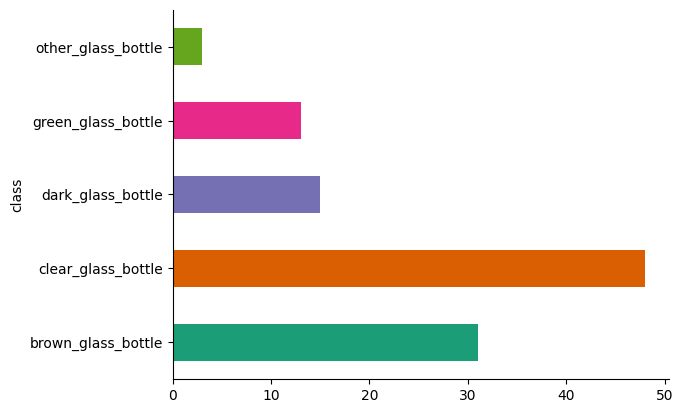

In [ ]:
def draw_box2(n0):

    ipath=ppaths[n0]
    image=cv2.imread(ipath)
    H,W=image.shape[0],image.shape[1]
    file=ipath.split('/')[-1]

    if PBOX[PBOX['file']==file] is not None:
        box=PBOX[PBOX['file']==file]
        box=box.reset_index(drop=True)
        #display(box)

        for i in range(len(box)):
            label=box.loc[i,'class']
            x=int(box.loc[i,'x'])
            y=int(box.loc[i,'y'])
            x2=int(box.loc[i,'x2'])
            y2=int(box.loc[i,'y2'])
            #print(label,x,y,x2,y2)
            cv2.putText(image, f'{label}', (x, int(y-4)),
                        cv2.FONT_HERSHEY_SIMPLEX, 1.0, (0,255,0),2)
            cv2.rectangle(image,(x,y),(x2,y2),(0,255,0),2) #green

    #plt.imshow(image)
    #plt.show()

    return image

In [ ]:
def create_animation(ims):
    fig=plt.figure(figsize=(12,8))
    im=plt.imshow(cv2.cvtColor(ims[0],cv2.COLOR_BGR2RGB))
    text = plt.text(0.05, 0.05, f'Slide {0}', transform=fig.transFigure, fontsize=14, color='blue')
    plt.axis('off')
    plt.close()

    def animate_func(i):
        im.set_array(cv2.cvtColor(ims[i],cv2.COLOR_BGR2RGB))
        text.set_text(f'Slide {20+i}')
        return [im]

    return animation.FuncAnimation(fig, animate_func, frames=len(ims), interval=1000)

In [ ]:
images2=[]
for i in tqdm(range(len(ppaths))):
    images2+=[draw_box2(i)]

100%|██████████| 46/46 [00:00<00:00, 100.73it/s]


In [ ]:
create_animation(images2)